Question: Are delays independent to time of day, or day of week?

Developer: TANMOY DAS <br>
Date: May 15, 2022


Outline of this Python Notebook:
1. Data Exploration
2. Premodeling (Feature Engineering)
3. Time Series Analysis

# Data Exploration

## Data Importing & Preprocessing

In [1]:
# import necessarry Python libraries
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import datetime

import matplotlib.pyplot as plt
import matplotlib
from matplotlib.pyplot import figure
import plotly.express as px

In [2]:
# import data from 2020 - 2022
data2020_2022_r = pd.read_excel('Data/FC Terminal Wait Times - 2020_2022.xlsx', sheet_name=['20202022']).copy() 

In [3]:
data2020_2022 = data2020_2022_r.get('20202022')
data2020_2022.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166148 entries, 0 to 166147
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Transponder       166148 non-null  int64         
 1   LocationIn        166148 non-null  object        
 2   LocationOut       166148 non-null  object        
 3   TimeIn            166148 non-null  datetime64[ns]
 4   TimeOut           166148 non-null  datetime64[ns]
 5   Difference (min)  166148 non-null  int64         
dtypes: datetime64[ns](2), int64(2), object(2)
memory usage: 7.6+ MB


In [4]:
# Convert datetime to date
data2020_2022['Date'] = pd.to_datetime(data2020_2022['TimeIn']).dt.date 

# Create DAY column
days = ['Mon','Tues','Wed','Thurs','Fri','Sat','Sun']
weekday = []
for i in data2020_2022['Date']:
    weekday.append(days[i.weekday()])
   # print(i)
data2020_2022['Weekday'] = weekday

# Create MONTH column
data2020_2022['Month'] = [i.strftime("%B") for i in data2020_2022['Date']]

# Rename column to "Delay"
data2020_2022.rename(columns = {'Difference (min)':'Delay'}, inplace = True)



In [5]:
# Create HOUR column
hours = ['07:00-07:59','08:00-08:59','09:00-09:59','10:00-10:59','11:00-11:59','12:00-12:59','13:00-13:59', 
        '14:00-14:59', '15:00-15:59', '16:00-16:59', '17:00-17:59', '18:00-18:59', '19:00-20:00']
Hours = []
for i in data2020_2022['TimeIn']:
    if (i.time() > datetime.time(7, 0, 0) and i.time() < datetime.time(8, 0, 0) ):
        Hours.append('07:00-07:59') 
    elif(i.time() >= datetime.time(8, 0, 0) and i.time() < datetime.time(9, 0, 0) ):
        Hours.append('08:00-08:59')
    elif(i.time() >= datetime.time(9, 0, 0) and i.time() < datetime.time(10, 0, 0) ):
        Hours.append('09:00-09:59')
    elif(i.time() >= datetime.time(10, 0, 0) and i.time() < datetime.time(11, 0, 0) ):
        Hours.append('10:00-10:59')
    elif(i.time() >= datetime.time(11, 0, 0) and i.time() < datetime.time(12, 0, 0) ):
        Hours.append('11:00-11:59')
    elif(i.time() >= datetime.time(12, 0, 0) and i.time() < datetime.time(13, 0, 0) ):
        Hours.append('12:00-12:59')
    elif(i.time() >= datetime.time(13, 0, 0) and i.time() < datetime.time(14, 0, 0) ):
        Hours.append('13:00-13:59')
    elif(i.time() >= datetime.time(14, 0, 0) and i.time() < datetime.time(15, 0, 0) ):
        Hours.append('14:00-14:59')
    elif(i.time() >= datetime.time(15, 0, 0) and i.time() < datetime.time(16, 0, 0) ):
        Hours.append('15:00-15:59')
    elif(i.time() >= datetime.time(16, 0, 0) and i.time() < datetime.time(17, 0, 0) ):
        Hours.append('16:00-16:59')
    elif(i.time() >= datetime.time(17, 0, 0) and i.time() < datetime.time(18, 0, 0) ):
        Hours.append('17:00-17:59')
    elif(i.time() >= datetime.time(18, 0, 0) and i.time() < datetime.time(19, 0, 0) ):
        Hours.append('18:00-18:59')
    else:
        Hours.append('19:00-20:00')
data2020_2022['Hours'] = Hours

In [6]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,8538,1(A),1(En),2020-01-02 10:32:53,2020-01-02 12:16:43,17,2020-01-02,Thurs,January,10:00-10:59
1,8282,1(A),1(En),2020-01-02 09:30:39,2020-01-02 12:18:23,18,2020-01-02,Thurs,January,09:00-09:59
2,36317,1(A),1(En),2020-01-02 10:18:46,2020-01-02 12:18:59,19,2020-01-02,Thurs,January,10:00-10:59
3,11391,1(A),1(En),2020-01-02 10:44:40,2020-01-02 12:21:06,21,2020-01-02,Thurs,January,10:00-10:59
4,16459,1(A),1(En),2020-01-02 12:01:28,2020-01-02 12:23:04,22,2020-01-02,Thurs,January,12:00-12:59
...,...,...,...,...,...,...,...,...,...,...
166143,8229,1(En),1(Ex),2022-03-31 17:58:28,2022-03-31 19:19:20,81,2022-03-31,Thurs,March,17:00-17:59
166144,8290,1(En),1(Ex),2022-03-31 19:04:19,2022-03-31 19:19:51,16,2022-03-31,Thurs,March,19:00-20:00
166145,8290,1(A),1(Ex),2022-03-31 18:46:42,2022-03-31 19:19:51,33,2022-03-31,Thurs,March,18:00-18:59
166146,38600,1(En),1(Ex),2022-03-31 18:49:29,2022-03-31 19:23:53,34,2022-03-31,Thurs,March,18:00-18:59


In [7]:
display(data2020_2022.groupby(['Weekday']).sum())

display(data2020_2022.groupby(['Weekday']).mean())


,Transponder,Delay
Weekday,,
Fri,642400297,1098174
Mon,588905159,972494
Sat,710912,974
Sun,92330,1056
Thurs,676989971,1096243
Tues,709147107,1121017
Wed,705954814,1173013


,Transponder,Delay
Weekday,,
Fri,20196.821360,34.526173
Mon,19936.529977,32.922374
Sat,17772.800000,24.350000
Sun,10258.888889,117.333333
Thurs,19977.277237,32.349003
Tues,20082.895047,31.746963
Wed,19855.847837,32.992434


In [8]:
display(data2020_2022.groupby(['Hours']).sum())

#display(data2022.groupby(['Hours']).mean())


,Transponder,Delay
Hours,,
07:00-07:59,1309676,2193
08:00-08:59,4255740,9808
09:00-09:59,37081123,77589
10:00-10:59,113856571,309654
11:00-11:59,298109787,578586
12:00-12:59,388595490,620540
13:00-13:59,401613575,567242
14:00-14:59,384360551,537659
15:00-15:59,261898125,503649


## Trend of DELAY over the years

In [9]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,8538,1(A),1(En),2020-01-02 10:32:53,2020-01-02 12:16:43,17,2020-01-02,Thurs,January,10:00-10:59
1,8282,1(A),1(En),2020-01-02 09:30:39,2020-01-02 12:18:23,18,2020-01-02,Thurs,January,09:00-09:59
2,36317,1(A),1(En),2020-01-02 10:18:46,2020-01-02 12:18:59,19,2020-01-02,Thurs,January,10:00-10:59
3,11391,1(A),1(En),2020-01-02 10:44:40,2020-01-02 12:21:06,21,2020-01-02,Thurs,January,10:00-10:59
4,16459,1(A),1(En),2020-01-02 12:01:28,2020-01-02 12:23:04,22,2020-01-02,Thurs,January,12:00-12:59
...,...,...,...,...,...,...,...,...,...,...
166143,8229,1(En),1(Ex),2022-03-31 17:58:28,2022-03-31 19:19:20,81,2022-03-31,Thurs,March,17:00-17:59
166144,8290,1(En),1(Ex),2022-03-31 19:04:19,2022-03-31 19:19:51,16,2022-03-31,Thurs,March,19:00-20:00
166145,8290,1(A),1(Ex),2022-03-31 18:46:42,2022-03-31 19:19:51,33,2022-03-31,Thurs,March,18:00-18:59
166146,38600,1(En),1(Ex),2022-03-31 18:49:29,2022-03-31 19:23:53,34,2022-03-31,Thurs,March,18:00-18:59


In [10]:
data2020_2022_groupbyDate = data2020_2022.groupby(['Date','Month','Weekday']).sum().reset_index()
data2020_2022_groupbyDate
# this Delay is delay of all truck in certain date 



,Date,Month,Weekday,Transponder,Delay
0,2020-01-02,January,Thurs,2761339,5797
1,2020-01-03,January,Fri,2308769,3717
2,2020-01-06,January,Mon,2212934,3215
3,2020-01-07,January,Tues,2460230,2206
4,2020-01-08,January,Wed,16022,115
...,...,...,...,...,...
569,2022-03-27,March,Sun,9100,317
570,2022-03-28,March,Mon,6720775,7841
571,2022-03-29,March,Tues,7743232,7181
572,2022-03-30,March,Wed,7532753,11073


In [11]:
max(data2020_2022_groupbyDate['Delay'])

44254

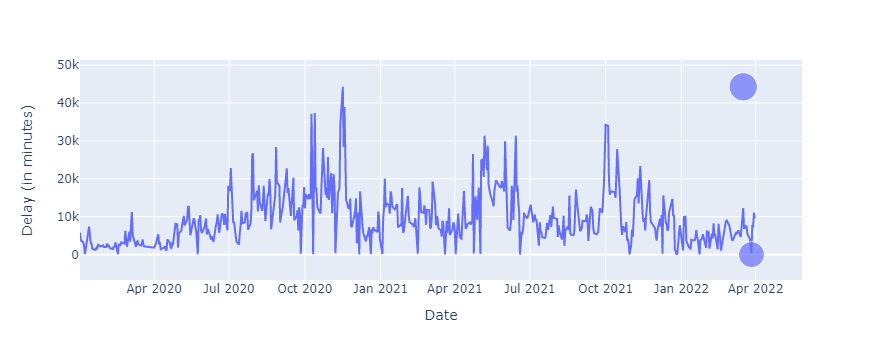

In [12]:
fig = px.line(data2020_2022_groupbyDate, x='Date', y= 'Delay', labels={'Delay': 'Delay (in minutes)'})
fig2 = px.scatter(x=['2022-03-17', '2022-03-27'], y=[max(data2020_2022_groupbyDate['Delay']), min(data2020_2022_groupbyDate['Delay'])],
                 size=[120,100])
#fig.add_trace(fig2.data[0])
fig.show()

The above Line graph tells us that there are lots of delay. But, does not tell us which days have more delays! 


## Trend of DELAY for days of week

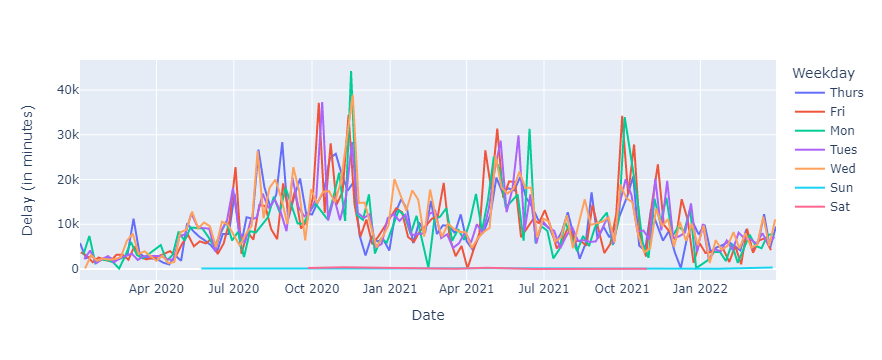

In [13]:
fig = px.line(data2020_2022_groupbyDate, x='Date', y= 'Delay', color='Weekday' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()
fig.write_image("Figures/LineplotWeekdayFC20202022.png")

No day is significantly better than the other! 

## Trend of DELAY for time of day


Lets split days into Morning, Afternoon & Evening 

In [14]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,8538,1(A),1(En),2020-01-02 10:32:53,2020-01-02 12:16:43,17,2020-01-02,Thurs,January,10:00-10:59
1,8282,1(A),1(En),2020-01-02 09:30:39,2020-01-02 12:18:23,18,2020-01-02,Thurs,January,09:00-09:59
2,36317,1(A),1(En),2020-01-02 10:18:46,2020-01-02 12:18:59,19,2020-01-02,Thurs,January,10:00-10:59
3,11391,1(A),1(En),2020-01-02 10:44:40,2020-01-02 12:21:06,21,2020-01-02,Thurs,January,10:00-10:59
4,16459,1(A),1(En),2020-01-02 12:01:28,2020-01-02 12:23:04,22,2020-01-02,Thurs,January,12:00-12:59
...,...,...,...,...,...,...,...,...,...,...
166143,8229,1(En),1(Ex),2022-03-31 17:58:28,2022-03-31 19:19:20,81,2022-03-31,Thurs,March,17:00-17:59
166144,8290,1(En),1(Ex),2022-03-31 19:04:19,2022-03-31 19:19:51,16,2022-03-31,Thurs,March,19:00-20:00
166145,8290,1(A),1(Ex),2022-03-31 18:46:42,2022-03-31 19:19:51,33,2022-03-31,Thurs,March,18:00-18:59
166146,38600,1(En),1(Ex),2022-03-31 18:49:29,2022-03-31 19:23:53,34,2022-03-31,Thurs,March,18:00-18:59


In [15]:
# hour category


In [16]:
timeofday = ['Morning','Early-afternoon','Late-afternoon','Evening']
TimeOfDayColumn = []
for i in data2020_2022['TimeIn']:
    if (i.time() > datetime.time(6, 0, 0) and i.time() < datetime.time(12, 0, 0) ):
        TimeOfDayColumn.append('Morning') 
    elif(i.time() >= datetime.time(12, 0, 0) and i.time() < datetime.time(15, 0, 0) ):
        TimeOfDayColumn.append('Early-afternoon')
    elif(i.time() >= datetime.time(15, 0, 0) and i.time() < datetime.time(18, 0, 0) ):
        TimeOfDayColumn.append('Late-afternoon')
    else:
        TimeOfDayColumn.append('Evening')
data2020_2022['Time Of Day'] = TimeOfDayColumn


In [17]:
data2020_2022_groupbyDate = data2020_2022.groupby(['Date','Month','Weekday']).sum().reset_index()
data2020_2022_groupbyDate
# this Delay is delay of all truck in certain date 



,Date,Month,Weekday,Transponder,Delay
0,2020-01-02,January,Thurs,2761339,5797
1,2020-01-03,January,Fri,2308769,3717
2,2020-01-06,January,Mon,2212934,3215
3,2020-01-07,January,Tues,2460230,2206
4,2020-01-08,January,Wed,16022,115
...,...,...,...,...,...
569,2022-03-27,March,Sun,9100,317
570,2022-03-28,March,Mon,6720775,7841
571,2022-03-29,March,Tues,7743232,7181
572,2022-03-30,March,Wed,7532753,11073


In [18]:
data2020_2022_groupbyTimeofDay = data2020_2022.groupby(['Date','Month','Time Of Day']).sum().reset_index()
data2020_2022_groupbyTimeofDay
# this Delay is delay of all truck in certain date 

,Date,Month,Time Of Day,Transponder,Delay
0,2020-01-02,January,Early-afternoon,842124,841
1,2020-01-02,January,Evening,681106,1896
2,2020-01-02,January,Late-afternoon,990696,2485
3,2020-01-02,January,Morning,247413,575
4,2020-01-03,January,Early-afternoon,678881,747
...,...,...,...,...,...
2224,2022-03-30,March,Morning,636518,533
2225,2022-03-31,March,Early-afternoon,2171798,2453
2226,2022-03-31,March,Evening,416349,639
2227,2022-03-31,March,Late-afternoon,2804772,4129


In [19]:
data2020_2022_groupbyHours = data2020_2022.groupby(['Date','Month','Hours']).sum().reset_index()
data2020_2022_groupbyHours
# this Delay is delay of all truck in certain date 

,Date,Month,Hours,Transponder,Delay
0,2020-01-02,January,09:00-09:59,8282,18
1,2020-01-02,January,10:00-10:59,64520,86
2,2020-01-02,January,11:00-11:59,174611,471
3,2020-01-02,January,12:00-12:59,230168,280
4,2020-01-02,January,13:00-13:59,326380,225
...,...,...,...,...,...
5981,2022-03-31,March,15:00-15:59,399075,1085
5982,2022-03-31,March,16:00-16:59,816731,1072
5983,2022-03-31,March,17:00-17:59,1588966,1972
5984,2022-03-31,March,18:00-18:59,408059,623


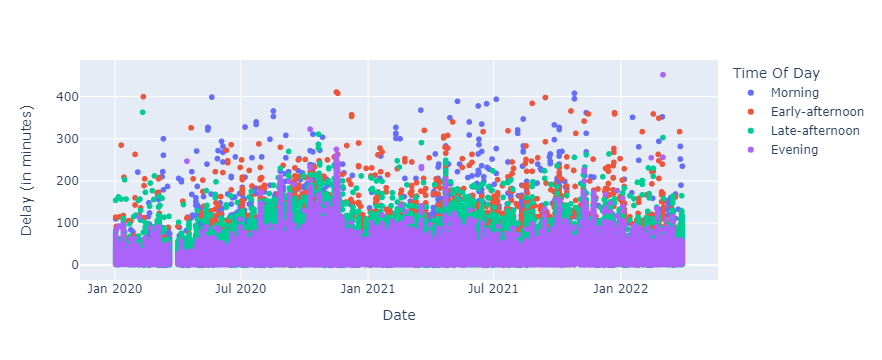

In [20]:
fig = px.scatter(data2020_2022, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()

Most of the truck leave quite quickly in the morning ++ ?? 


In [21]:
# Number of trucks in the morning vs evening


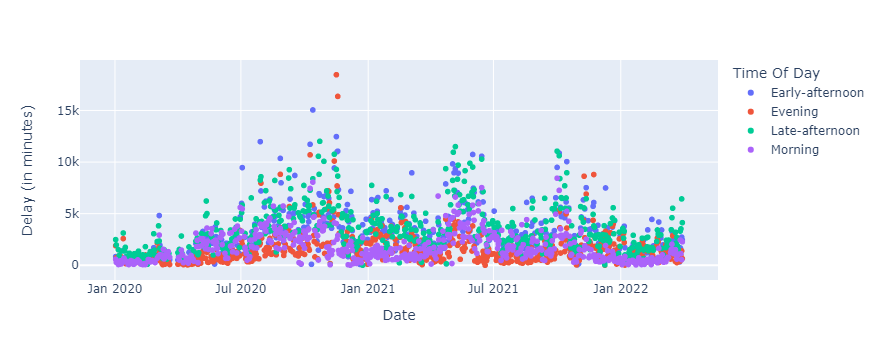

In [22]:

fig = px.scatter(data2020_2022_groupbyTimeofDay, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()

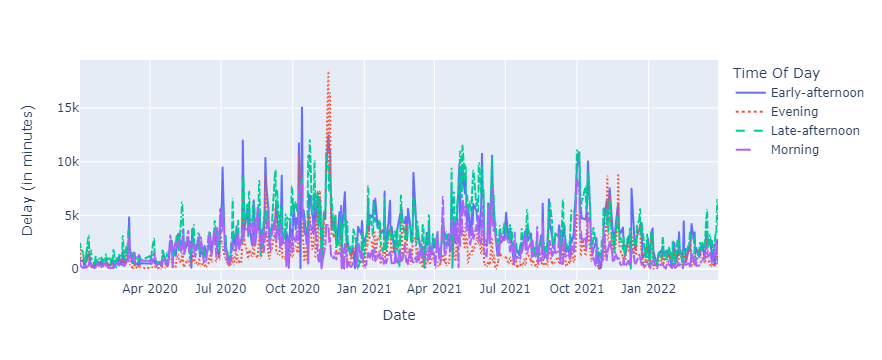

In [23]:

fig = px.line(data2020_2022_groupbyTimeofDay, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'}, line_dash='Time Of Day')
fig.show()
fig.write_image("Figures/LineplotTimeofDayFC20202022.png")

In recent weeks, we have more delays in the evening. So, we should reschudle our evening trucks on other time (maybe extending current opening hour of terminal gates, which is 16:30 as per last week). After all, leaving of trucks during high-peak office hour & pedestrian walk in this summer time is NOT impressive.  

In [ ]:
#pip install chart-studio

### Bubble Plot

In [26]:
data2020_2022_groupbyTimeofDayBubblePlot = data2020_2022.groupby(['Date','Month','Time Of Day', 'Weekday', 'LocationIn']).sum().reset_index()
data2020_2022_groupbyTimeofDayBubblePlot

,Date,Month,Time Of Day,Weekday,LocationIn,Transponder,Delay
0,2020-01-02,January,Early-afternoon,Thurs,1(A),842124,841
1,2020-01-02,January,Evening,Thurs,1(A),681106,1896
2,2020-01-02,January,Late-afternoon,Thurs,1(A),990696,2485
3,2020-01-02,January,Morning,Thurs,1(A),247413,575
4,2020-01-03,January,Early-afternoon,Fri,1(A),678881,747
...,...,...,...,...,...,...,...
3920,2022-03-31,March,Evening,Thurs,1(En),199523,294
3921,2022-03-31,March,Late-afternoon,Thurs,1(A),1765748,2714
3922,2022-03-31,March,Late-afternoon,Thurs,1(En),1039024,1415
3923,2022-03-31,March,Morning,Thurs,1(A),982529,1732


In [27]:
data2020_2022_groupbyTimeofDayBubblePlot.columns

Index(['Date', 'Month', 'Time Of Day', 'Weekday', 'LocationIn', 'Transponder',
       'Delay'],
      dtype='object')

In [28]:
data2020_2022_groupbyTimeofDayBubblePlot.Transponder.unique()
data2020_2022_groupbyTimeofDayBubblePlot.nunique()

Date            574
Month            12
Time Of Day       4
Weekday           7
LocationIn        2
Transponder    3912
Delay          2182
dtype: int64

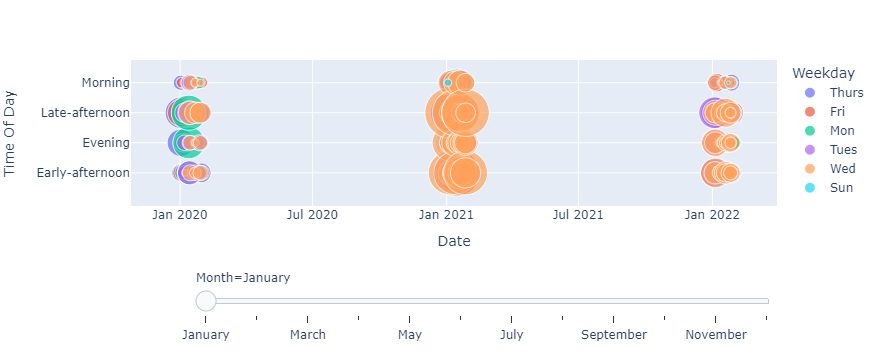

<Figure size 2400x1800 with 0 Axes>

In [29]:

figure(figsize=(8, 6), dpi=300)
fig = px.scatter(data2020_2022_groupbyTimeofDayBubblePlot, x="Date", y="Time Of Day", animation_frame="Month", # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Weekday",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()
fig.write_image("Figures/BubbleplotTimeofDayFC20202022.png")

Delay is not dependent on day of week (linegraph), but depends on time of day, more in afternoon.

Now one can argue how I categohour into time of day? Show hourly delay for same dataset.. is the trend similar? Lets find out in the "Trend of Delay by Hours" section

## Trend of DELAY by Hours

In [30]:
data2020_2022_groupbyHours = data2020_2022.groupby(['Date','Month','Time Of Day', 'Weekday', 'LocationIn', 'Hours']).sum().reset_index()
data2020_2022_groupbyHours

,Date,Month,Time Of Day,Weekday,LocationIn,Hours,Transponder,Delay
0,2020-01-02,January,Early-afternoon,Thurs,1(A),12:00-12:59,230168,280
1,2020-01-02,January,Early-afternoon,Thurs,1(A),13:00-13:59,326380,225
2,2020-01-02,January,Early-afternoon,Thurs,1(A),14:00-14:59,285576,336
3,2020-01-02,January,Evening,Thurs,1(A),18:00-18:59,395914,1094
4,2020-01-02,January,Evening,Thurs,1(A),19:00-20:00,285192,802
...,...,...,...,...,...,...,...,...
9515,2022-03-31,March,Late-afternoon,Thurs,1(En),17:00-17:59,577324,841
9516,2022-03-31,March,Morning,Thurs,1(A),09:00-09:59,245968,222
9517,2022-03-31,March,Morning,Thurs,1(A),10:00-10:59,344842,1120
9518,2022-03-31,March,Morning,Thurs,1(A),11:00-11:59,391719,390


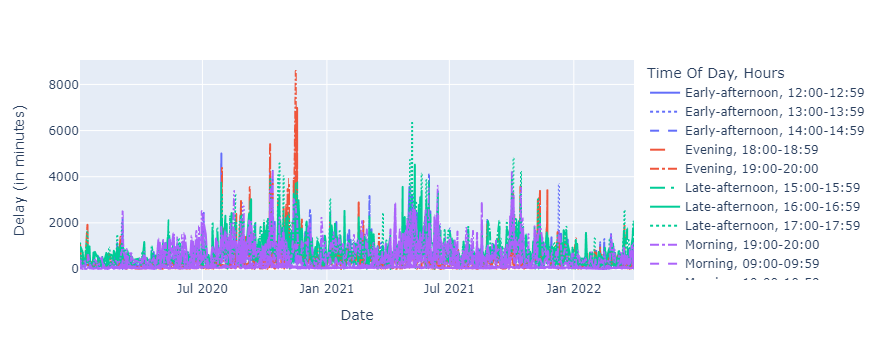

In [31]:
fig = px.line(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Time Of Day' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'}, line_dash='Hours')
fig.show()
fig.write_image("Figures/LineJanMarFC20202022.png")

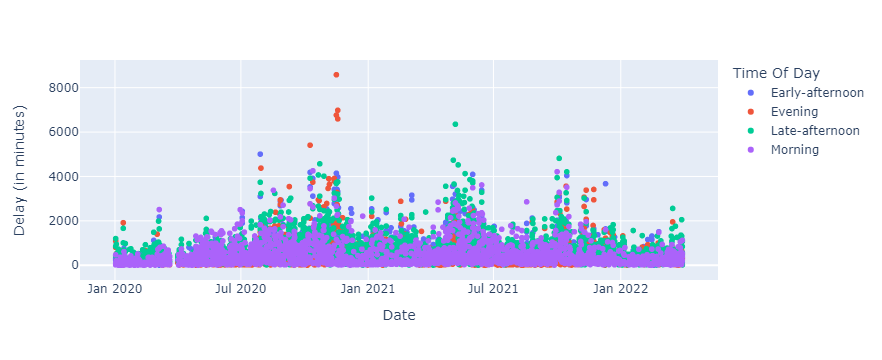

In [32]:
fig = px.scatter(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Time Of Day' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'})
fig.show()
fig.write_image("Figures/scatterplotTimeofDayFC20202022.png")

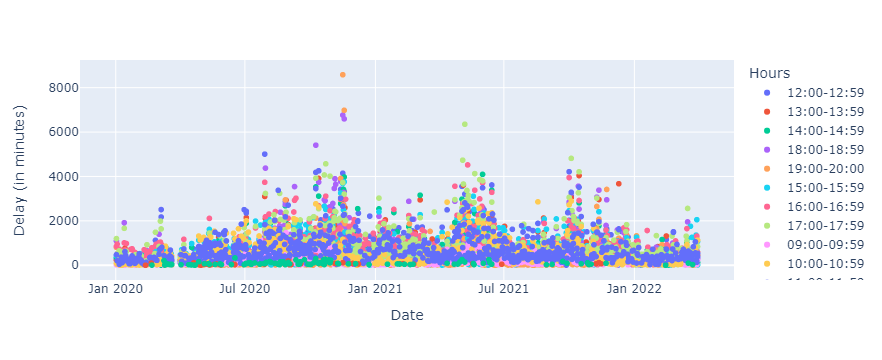

In [33]:
fig = px.scatter(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Hours' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'}) #, legend={'traceorder':'normal'}
fig.show() 
# ++ change color pallete & transparency alpha 

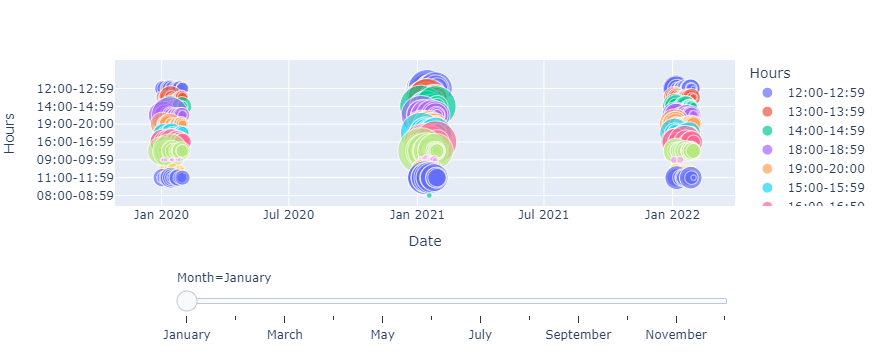

<Figure size 2400x1800 with 0 Axes>

In [34]:
figure(figsize=(8, 6), dpi=300)
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Hours",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

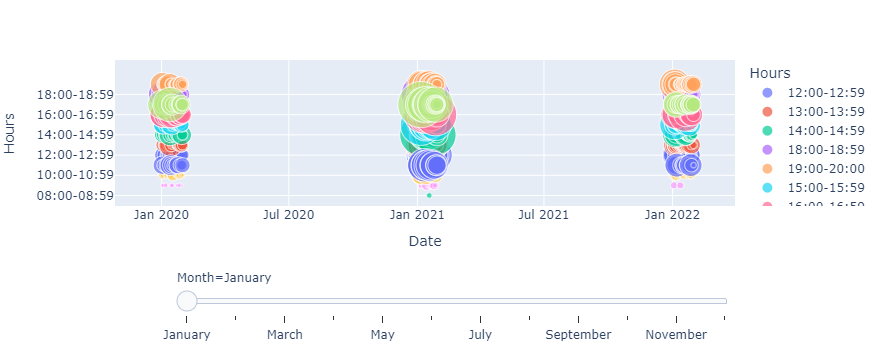

In [35]:
#fig=plt.figure(figsize=(12,12), dpi= 100, facecolor='w', edgecolor='k')
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Hours",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons

fig.update_yaxes(categoryorder="category ascending")
fig.show()

fig.write_image("Figures/BubbleplotHourFC20202022.png")

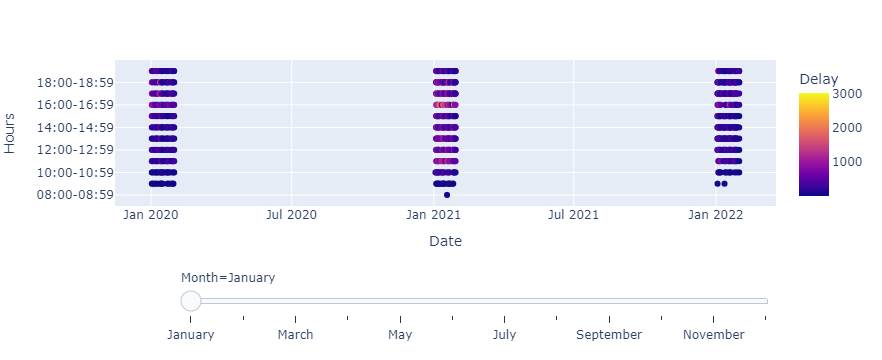

In [36]:
#fig=plt.figure(figsize=(12,12), dpi= 100, facecolor='w', edgecolor='k')
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           color="Delay"
           ) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons

fig.update_yaxes(categoryorder="category ascending")
fig.show()

fig.write_image("Figures/scatterplotHourFC20202022.png")

In [37]:
#pip install -U kaleido

## Exploring delay of certain truck using certain gate

In [44]:
# Lets read data for Transponder 17107

mask = data2020_2022['Transponder']==17107 
data_T17107 = data2020_2022[mask]


Transponder 8156 & LocationIn = 2(En)

In [43]:
data_T17107

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours,Time Of Day
10796,17107,1(A),1(En),2020-05-04 13:12:42,2020-05-04 13:20:20,8,2020-05-04,Mon,May,13:00-13:59,Early-afternoon
10809,17107,1(En),1(Ex),2020-05-04 13:20:20,2020-05-04 13:31:10,11,2020-05-04,Mon,May,13:00-13:59,Early-afternoon
10810,17107,1(A),1(Ex),2020-05-04 13:12:42,2020-05-04 13:31:10,18,2020-05-04,Mon,May,13:00-13:59,Early-afternoon
10877,17107,1(A),1(En),2020-05-04 16:02:44,2020-05-04 16:33:29,31,2020-05-04,Mon,May,16:00-16:59,Late-afternoon
10899,17107,1(En),1(Ex),2020-05-04 16:33:29,2020-05-04 16:50:31,17,2020-05-04,Mon,May,16:00-16:59,Late-afternoon
...,...,...,...,...,...,...,...,...,...,...,...
165481,17107,1(A),1(Ex),2022-03-29 17:28:41,2022-03-29 17:47:57,19,2022-03-29,Tues,March,17:00-17:59,Late-afternoon
165697,17107,1(A),1(En),2022-03-30 15:13:43,2022-03-30 16:26:43,27,2022-03-30,Wed,March,15:00-15:59,Late-afternoon
165747,17107,1(En),1(Ex),2022-03-30 16:26:43,2022-03-30 17:39:30,73,2022-03-30,Wed,March,16:00-16:59,Late-afternoon
165748,17107,1(A),1(Ex),2022-03-30 15:13:43,2022-03-30 17:39:30,100,2022-03-30,Wed,March,15:00-15:59,Late-afternoon


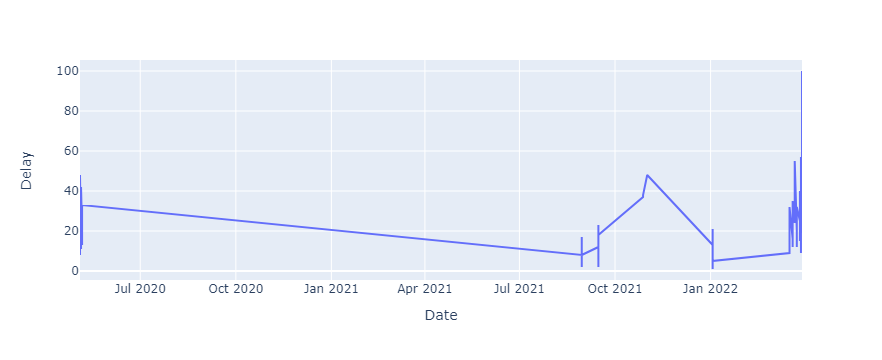

In [46]:
fig = px.line(data_T17107, x='Date', y= 'Delay')
fig.show() 

# Remarks